# **Install Requirements**

In [271]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import torch
import glob
import torch.nn as nn
import torch.optim as optim
import seaborn as sns
from torch.utils.data import DataLoader
from torchvision.transforms import transforms
import os
from torch.optim import Adam
from torch.autograd import Variable
import torchvision
import pathlib
import cv2
import re
import torch
import torchvision
from torchvision import transforms 
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator
from torch.utils.data import DataLoader, Dataset
from torch.utils.data.sampler import SequentialSampler
from matplotlib import pyplot as plt

In [272]:
#we are connecting Google Drive and Google Colab
from google.colab import drive

In [ ]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [273]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import zipfile

with zipfile.ZipFile("/content/drive/MyDrive/aiunict-2023.zip","r") as zip_ref:
       zip_ref.extractall("/content/drive/MyDrive/aiunict-2023")

# **Explore Dataset**

In [ ]:
# To list all the file paths of the directory

import os

for dirname, _, filenames in os.walk('/content/drive/MyDrive/aiunict-2023'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/drive/MyDrive/aiunict-2023/submission.csv
/content/drive/MyDrive/aiunict-2023/test.csv
/content/drive/MyDrive/aiunict-2023/train.csv
/content/drive/MyDrive/aiunict-2023/test/000.jpg
/content/drive/MyDrive/aiunict-2023/test/001.jpg
/content/drive/MyDrive/aiunict-2023/test/002.jpg
/content/drive/MyDrive/aiunict-2023/test/003.jpg
/content/drive/MyDrive/aiunict-2023/test/004.jpg
/content/drive/MyDrive/aiunict-2023/test/005.jpg
/content/drive/MyDrive/aiunict-2023/test/006.jpg
/content/drive/MyDrive/aiunict-2023/test/007.jpg
/content/drive/MyDrive/aiunict-2023/test/008.jpg
/content/drive/MyDrive/aiunict-2023/test/009.jpg
/content/drive/MyDrive/aiunict-2023/test/010.jpg
/content/drive/MyDrive/aiunict-2023/test/011.jpg
/content/drive/MyDrive/aiunict-2023/test/012.jpg
/content/drive/MyDrive/aiunict-2023/test/013.jpg
/content/drive/MyDrive/aiunict-2023/test/014.jpg
/content/drive/MyDrive/aiunict-2023/test/015.jpg
/content/drive/MyDrive/aiunict-2023/test/016.jpg
/content/drive/MyDrive/ai

In [274]:
#train and test data directory
from torchvision.datasets import ImageFolder
train = '/content/drive/MyDrive/aiunict-2023/train'
test = '/content/drive/MyDrive/aiunict-2023/test'

# Load CSV files
train_df = pd.read_csv("/content/drive/MyDrive/aiunict-2023/train.csv")
test_df = pd.read_csv("/content/drive/MyDrive/aiunict-2023/test.csv")

First image of each class in the train dataset:


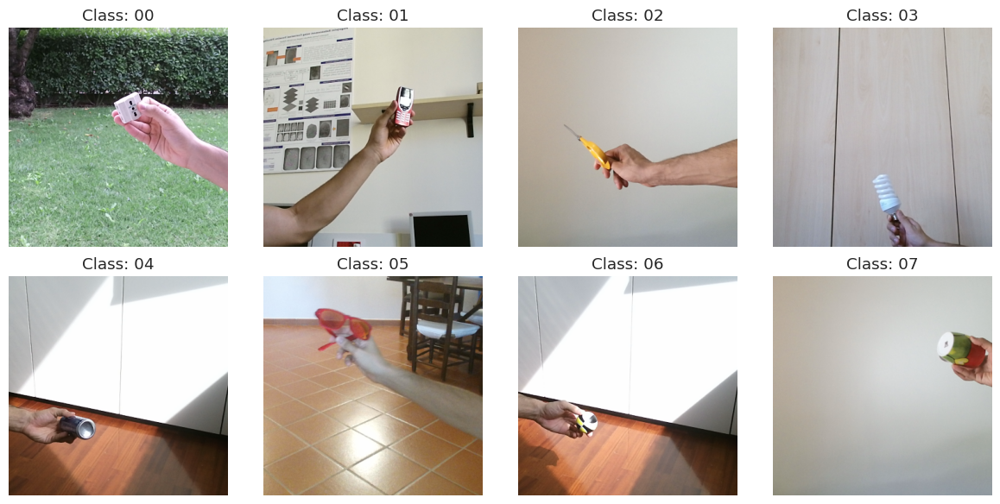

In [275]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Show first image of each class in the train dataset
train_classes = sorted(os.listdir(train))
print("First image of each class in the train dataset:")
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(12, 6))

for i, cls in enumerate(train_classes[:8]):  # Loop through the first 8 classes
    row = i // 4
    col = i % 4
    axs[row, col].set_title(f"Class: {cls}")
    class_dir = os.path.join(train, cls)  # Updated train directory
    files = sorted(os.listdir(class_dir))
    if len(files) > 0:
        image_path = os.path.join(class_dir, files[0])
        image = Image.open(image_path)
        axs[row, col].imshow(image)
    axs[row, col].axis('off')

plt.tight_layout()
plt.show()

First 8 images of the test dataset:


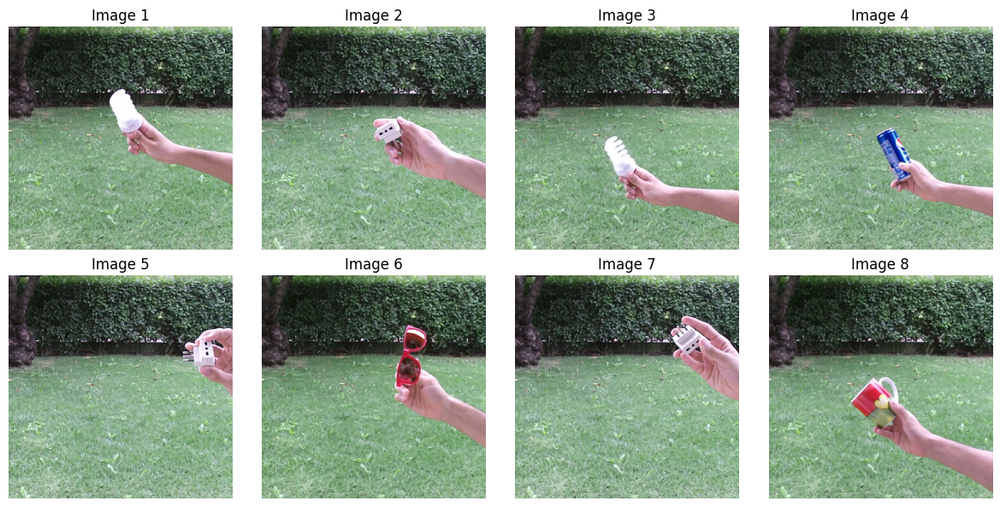

In [ ]:
# Show the first 8 images of the test dataset

test_files = sorted(os.listdir(test))
print("First 8 images of the test dataset:")
num_test_cols = 4  # Number of images per row for test dataset
num_test_rows = (8 + num_test_cols - 1) // num_test_cols  # Compute number of rows needed for test dataset
fig, axs = plt.subplots(nrows=num_test_rows, ncols=num_test_cols, figsize=(12, 6))

# Reshape axs array for test dataset
axs = axs.reshape(-1)

for i in range(min(8, len(test_files))):
    image_path = os.path.join(test, test_files[i])
    image = Image.open(image_path)
    axs[i].imshow(image)
    axs[i].axis('off')
    axs[i].set_title(f"Image {i+1}")

plt.tight_layout()
plt.show()

# **Explore the Bounding Boxes**

In [ ]:
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/aiunict-2023/train.csv")
df.describe()

,x1,y1,x2,y2,class
count,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000
mean,112.336250,123.285000,239.336250,250.285000,3.500000
std,59.321782,54.641764,59.321782,54.641764,2.292004
min,-1.000000,-1.000000,126.000000,126.000000,0.000000
25%,65.000000,77.000000,192.000000,204.000000,1.750000
50%,117.000000,121.000000,244.000000,248.000000,3.500000
75%,155.000000,169.000000,282.000000,296.000000,5.250000
max,220.000000,222.000000,347.000000,349.000000,7.000000


In [ ]:
df['x1'] = df['x1'].abs()
df['y1'] = df['y1'].abs()

df.describe()

,x1,y1,x2,y2,class
count,1600.000000,1600.000000,1600.000000,1600.000000,1600.000000
mean,112.338750,123.287500,239.336250,250.285000,3.500000
std,59.317045,54.636119,59.321782,54.641764,2.292004
min,0.000000,0.000000,126.000000,126.000000,0.000000
25%,65.000000,77.000000,192.000000,204.000000,1.750000
50%,117.000000,121.000000,244.000000,248.000000,3.500000
75%,155.000000,169.000000,282.000000,296.000000,5.250000
max,220.000000,222.000000,347.000000,349.000000,7.000000


# **Exctract Bounding Box**

In [ ]:
import cv2
import os 
import matplotlib.pyplot as plt

im_path = os.path.join(train, train_df["image"][0])
im = cv2.imread(im_path)

if im is not None:
    print(im.shape)
    x1 = train_df["x1"][0]
    y1 = train_df["y1"][0]
    width = train_df["x2"][0] - x1
    height = train_df["y2"][0] - y1

    cropped_im = im[y1:y1+height, x1:x1+width]
    print(cropped_im.shape)

    masked = cv2.rectangle(im.copy(), (x1, y1), (x1+width, y1+height), (0, 0, 255), thickness=3)
else:
    print(f"Error: Failed to load the image at path '{im_path}'")

(350, 350, 3)
(127, 127, 3)


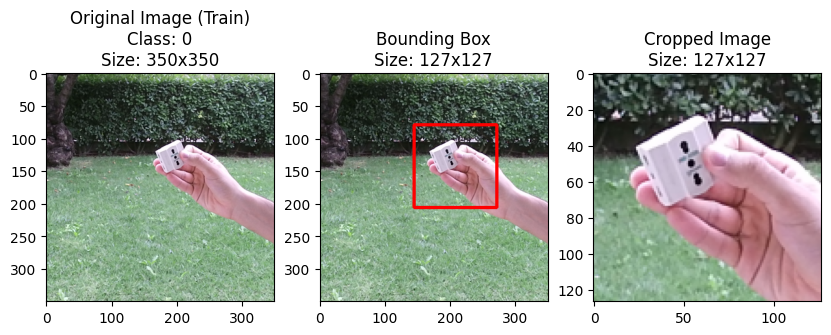

In [ ]:
# Showing the first image of train with its related bounding box

import matplotlib.pyplot as plt

# Plotting
plt.figure(figsize=(10, 8))

# Class name above the images
class_name = train_df["class"][0]

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.title(f"Original Image (Train)\nClass: {class_name}\nSize: {im.shape[0]}x{im.shape[1]}")

plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(masked, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.title(f"Bounding Box\nSize: {width}x{height}")

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(cropped_im, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
plt.title(f"Cropped Image\nSize: {cropped_im.shape[0]}x{cropped_im.shape[1]}")

plt.show()

# **Crop and Remove the Image Background**

(350, 350, 3)
(127, 127, 3)


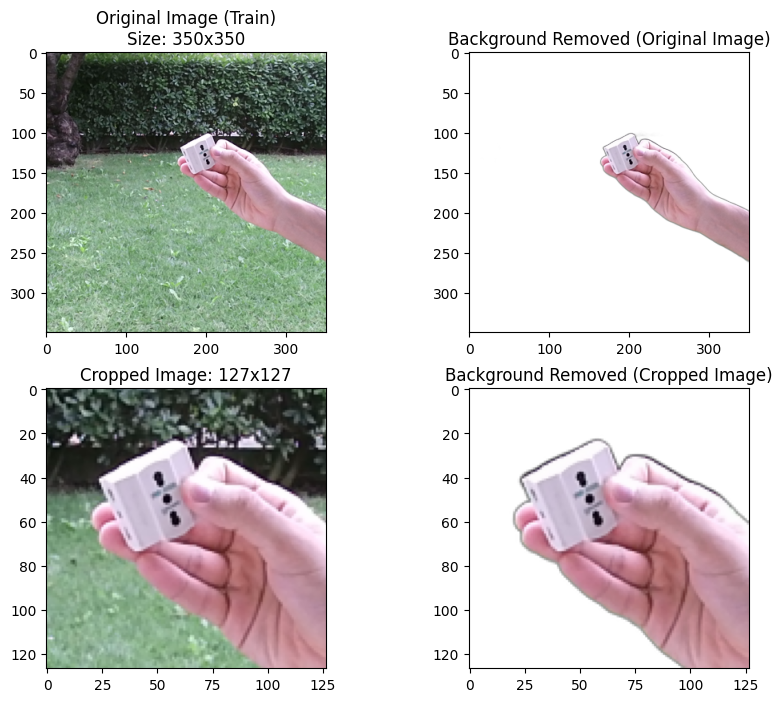

In [ ]:
# Removing the background for the first original and the cropped image in the train dataset

from rembg import remove
from PIL import Image
import cv2
import os
import matplotlib.pyplot as plt

im_path = os.path.join(train, train_df["image"][0])
im = cv2.imread(im_path)

if im is not None:
    print(im.shape)
    x1 = train_df["x1"][0]
    y1 = train_df["y1"][0]
    width = train_df["x2"][0] - x1
    height = train_df["y2"][0] - y1

    cropped_im = im[y1:y1+height, x1:x1+width]
    print(cropped_im.shape)

    # Convert the images to PIL Image format
    original_image = Image.fromarray(cv2.cvtColor(im, cv2.COLOR_BGR2RGB))
    cropped_image = Image.fromarray(cv2.cvtColor(cropped_im, cv2.COLOR_BGR2RGB))

    # Removing the background from the original image
    output_original = remove(original_image)

    # Removing the background from the cropped image
    output_cropped = remove(cropped_image)

    # Displaying the images
    plt.figure(figsize=(10, 8))

    plt.subplot(2, 2, 1)
    plt.imshow(original_image)
    plt.title(f"Original Image (Train)\nSize: {im.shape[0]}x{im.shape[1]}")

    plt.subplot(2, 2, 2)
    plt.imshow(output_original)
    plt.title("Background Removed (Original Image)")

    plt.subplot(2, 2, 3)
    plt.imshow(cropped_image)
    plt.title(f"Cropped Image: {cropped_im.shape[0]}x{cropped_im.shape[1]}")  # Modified title for cropped image

    plt.subplot(2, 2, 4)
    plt.imshow(output_cropped)
    plt.title("Background Removed (Cropped Image)")

    plt.show()
else:
    print(f"Error: Failed to load the image at path '{im_path}'")

In [ ]:
train_dir_crop = '/content/drive/MyDrive/aiunict-2023/train_crop'
test_dir_crop = '/content/drive/MyDrive/aiunict-2023/test_crop'

# **Cropping the datasets train/ test**

**Cropping the train dataset**

In [ ]:
# Cropping the train dataset and save in train_crop

import os
import csv
from PIL import Image
import torch
import torchvision.transforms as transforms

# Crop image using bounding box
def crop_image(image, bbox):
    return image.crop((bbox[0], bbox[1], bbox[2], bbox[3]))

# Train path directory
input_dir = '/content/drive/MyDrive/aiunict-2023/train'

# Uploading train.csv which includes bounding box
csv_file = '/content/drive/MyDrive/aiunict-2023/train.csv'

# Output directory path for cropped images
output_dir = '/content/drive/MyDrive/aiunict-2023/train_crop'

# Creating the output directory if it doesn't already exist
os.makedirs(output_dir, exist_ok=True)

# Extracting bounding boxes from train.csv
with open(csv_file, 'r') as file:
    csv_reader = csv.reader(file)
    next(csv_reader)  # Skip the header line
    for row in csv_reader:
        image_name = row[0]
        bbox = [int(val) for val in row[1:]]  # Convert coordinates to integers
        
        # Constructing the full path to the image
        image_path = os.path.join(input_dir, image_name)
        
        # Image upload using PIL
        image = Image.open(image_path)
        
        # Image cropping using the bounding box
        cropped_image = crop_image(image, bbox)
        
        # Saving the image in the corresponding output directory
        output_subdir = os.path.join(output_dir, os.path.dirname(image_name))
        os.makedirs(output_subdir, exist_ok=True)
        output_path = os.path.join(output_subdir, os.path.basename(image_name))
        cropped_image.save(output_path)

print("Cropped and saved successfully.")

Cropped and saved successfully.


**Cropping the test dataset**

In [ ]:
# Cropping the test dataset and save in test_crop

# Crop image using bounding box
def crop_image(image, bbox):
    return image.crop((bbox[0], bbox[1], bbox[2], bbox[3]))

# Train path directory
input_dir = '/content/drive/MyDrive/aiunict-2023/test'

# Uploading train.csv which includes bounding box
csv_file = '/content/drive/MyDrive/aiunict-2023/test.csv'

# Output directory path for cropped images
output_dir = '/content/drive/MyDrive/aiunict-2023/test_crop'

# Creating the output directory if it doesn't already exist
os.makedirs(output_dir, exist_ok=True)

# Extracting bounding boxes from train.csv
with open(csv_file, 'r') as file:
    csv_reader = csv.reader(file)
    next(csv_reader)  # Skip the header line
    for row in csv_reader:
        image_name = row[0]
        bbox = [int(val) for val in row[1:]]  # Convert coordinates to integers
        
        # Constructing the full path to the image
        image_path = os.path.join(input_dir, image_name)
        
        # Image upload using PIL
        image = Image.open(image_path)
        
        # Image cropping using the bounding box
        cropped_image = crop_image(image, bbox)
        
        # Saving the image in the corresponding output directory
        output_subdir = os.path.join(output_dir, os.path.dirname(image_name))
        os.makedirs(output_subdir, exist_ok=True)
        output_path = os.path.join(output_subdir, os.path.basename(image_name))
        cropped_image.save(output_path)

print("Cropped and saved successfully.")

Cropped and saved successfully.


# **Image Preprocessing**

**Remove the background from train_crop**

In [ ]:
# Remove the background from train_crop dataset and save in train_crop_nb

def process_images(source_dir, target_dir):
    if not os.path.exists(target_dir):
        os.makedirs(target_dir)

    image_extensions = ['.png']  
    
    for root, _, files in os.walk(source_dir):
        for file_name in files:
            file_ext = os.path.splitext(file_name)[1].lower()
            if file_ext in image_extensions:
                source_path = os.path.join(root, file_name)
                target_path = os.path.join(target_dir, file_name)
                
                # Load the image
                input_image = Image.open(source_path)
                
                # Removing the background from the input image
                output_image = remove(input_image)
                
                # Save the output image to the target directory
                output_image.save(target_path)
                
    print("Background removal complete.")

# Specify the source and target directories
train_crop_dir = '/content/drive/MyDrive/aiunict-2023/train_crop'
# test_crop_dir = '/content/drive/MyDrive/aiunict-2023/test_crop'
train_crop_nb_dir = '/content/drive/MyDrive/aiunict-2023/train_crop_nb'
# test_crop_nb_dir = '/content/drive/MyDrive/aiunict-2023/test_crop_nb'

# Process the images in train_crop directory and save the output to train_crop_nb directory
process_images(train_crop_dir, train_crop_nb_dir)

# Process the images in test_crop directory and save the output to test_crop_nb directory
process_images(test_crop_dir, test_crop_nb_dir)

print("Background removal for all images complete.")


Background removal complete.
Background removal complete.
Background removal for all images complete.


In [ ]:
!pip install rembg


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.1/57.1 kB 9.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 90.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 41.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 123.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.7/47.7 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 12.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 114.5/114.5 kB 17.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 30.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━

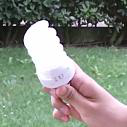

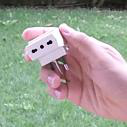

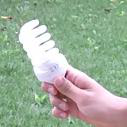

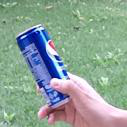

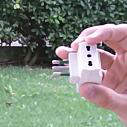

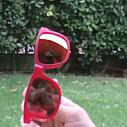

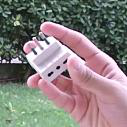

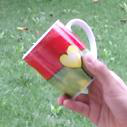

In [ ]:
# Showing the first 8 images of the test_crop

from PIL import Image
import os

image_dir = '/content/drive/MyDrive/aiunict-2023/test_crop'

# Get the list of image files in the directory
image_files = sorted([f for f in os.listdir(image_dir) if f.endswith('.jpg')])

# Display the first 8 images
for i in range(8):
    image_path = os.path.join(image_dir, image_files[i])
    image = Image.open(image_path)
    image.show()


In [ ]:
# Removing the background of test_crop and save in test_crop_nb (backgrounds turn all in Black!)

# from PIL import Image
# import os
# from rembg import remove
# import shutil

# source_dir = '/content/drive/MyDrive/aiunict-2023/test_crop'
# target_dir = '/content/drive/MyDrive/aiunict-2023/test_crop_nb'

# # Delete existing files in target directory
# if os.path.exists(target_dir):
#     shutil.rmtree(target_dir)

# # Create the target directory
# os.makedirs(target_dir)

# # Get the list of image files in the directory
# image_files = sorted([f for f in os.listdir(source_dir) if f.endswith('.jpg')])

# # Process the first 8 images
# for i in range(8):
#     source_path = os.path.join(source_dir, image_files[i])
#     target_path = os.path.join(target_dir, image_files[i])

#     # Load the image
#     input_image = Image.open(source_path)

#     # Convert the image to RGBA format
#     input_image = input_image.convert("RGBA")

#     # Removing the background from the input image
#     output_image = remove(input_image)

#     # Convert the output image to RGB format and discard the alpha channel
#     output_image = output_image.convert("RGB")

#     # Save the output image to the target directory as JPEG
#     output_image.save(target_path, "JPEG")

#     # Display the processed image
#     output_image.show()


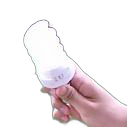

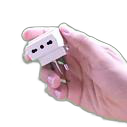

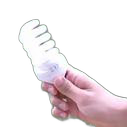

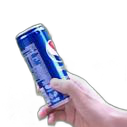

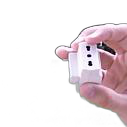

...

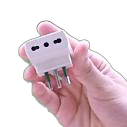

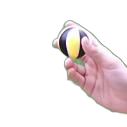

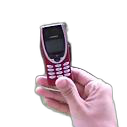

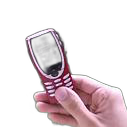

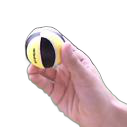

In [ ]:
# Removing the background of test_crop and save in test_crop_nb

from PIL import Image
import os
from rembg import remove
import shutil

source_dir = '/content/drive/MyDrive/aiunict-2023/test_crop'
target_dir = '/content/drive/MyDrive/aiunict-2023/test_crop_nb'

# Delete existing files in target directory
if os.path.exists(target_dir):
    shutil.rmtree(target_dir)

# Create the target directory
os.makedirs(target_dir)

# Get the list of image files in the directory
image_files = sorted([f for f in os.listdir(source_dir) if f.endswith('.jpg')])

# Process all images
for image_file in image_files:
    source_path = os.path.join(source_dir, image_file)
    target_path = os.path.join(target_dir, image_file)

    # Load the image
    input_image = Image.open(source_path)

    # Convert the image to RGBA format
    input_image = input_image.convert("RGBA")

    # Removing the background from the input image
    output_image = remove(input_image)

    # Save the output image to the target directory as PNG to preserve transparency
    output_image.save(target_path, "PNG")

    # Display the processed image
    output_image.show()


**Image Preprocessing**

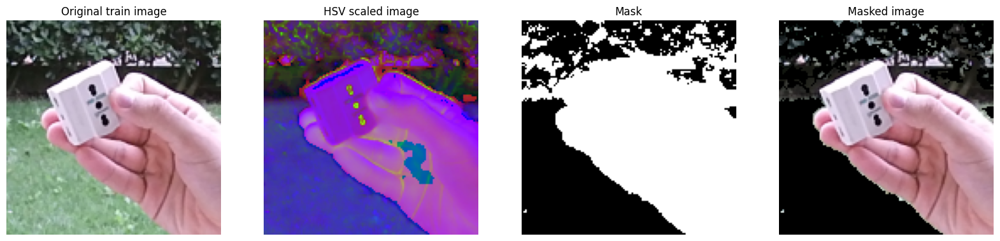

In [ ]:
# Showing the masking process

import cv2
import matplotlib.pyplot as plt
import numpy as np

# Path to the image
image_path = '/content/drive/MyDrive/aiunict-2023/train_crop/00/00_000.png'

# Load the original cropped image
img = cv2.imread(image_path)

# Convert to RGB color space
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Convert to HSV scale
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

# Create a mask
mask = cv2.inRange(hsv, (36, 25, 25), (89, 255, 255))  # Green color Hue: [36, 89], Saturation & Value: [25, 255]
mask = cv2.bitwise_not(mask)

# Apply the mask
imask = mask > 0
green = np.zeros_like(img, np.uint8)
green[imask] = img[imask]

# Convert the masked image to RGB color space
green_rgb = cv2.cvtColor(green, cv2.COLOR_BGR2RGB)

# Display the images in one row
fig, axs = plt.subplots(1, 4, figsize=(20, 5))

# Original cropped image
axs[0].imshow(img_rgb)
axs[0].axis('off')
axs[0].set_title('Original train image')

# HSV scaled image
axs[1].imshow(hsv)
axs[1].axis('off')
axs[1].set_title('HSV scaled image')

# Mask
axs[2].imshow(mask, cmap='gray')
axs[2].axis('off')
axs[2].set_title('Mask')

# Masked image
axs[3].imshow(green_rgb)
axs[3].axis('off')
axs[3].set_title('Masked image')

# Display the figure
plt.show()


**Apply the masking on train_crop**

In [ ]:
# Apply the masking on train_crop and save in train_crop_masked

import cv2
import os
import numpy as np
from PIL import Image

def background_remove(img):
    img = np.asarray(img)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    mask = cv2.inRange(hsv, (36, 25, 25), (89, 255, 255))
    mask = cv2.bitwise_not(mask)
    imask = mask > 0
    green = np.zeros_like(img, np.uint8)
    green[imask] = img[imask]
    green = Image.fromarray(green)
    return green

input_folder = '/content/drive/MyDrive/aiunict-2023/train_crop'  # Input folder containing subdirectories
output_folder = '/content/drive/MyDrive/aiunict-2023/train_crop_masked'  # Output folder for edited images

# Make sure the output folder exists, otherwise create it
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# List of subdirectories in the input folder
subdir_list = os.listdir(input_folder)

# Iterate over all subdirectories in the input folder
for subdir_name in subdir_list:
    # Create the full path to the input subdirectory
    input_subdir = os.path.join(input_folder, subdir_name)

    # Create the corresponding output subdirectory in the masked folder
    output_subdir = os.path.join(output_folder, subdir_name)
    if not os.path.exists(output_subdir):
        os.makedirs(output_subdir)

    # List of files in the input subdirectory
    file_list = os.listdir(input_subdir)

    # Iterate over all files in the input subdirectory
    for file_name in file_list:
        # Create the full path to the input file
        input_path = os.path.join(input_subdir, file_name)

        # Upload the input image
        img = cv2.imread(input_path)

        # Apply the background removal function
        processed_img = background_remove(img)

        # Convert processed image to numpy array
        processed_img_np = np.asarray(processed_img)

        # Create a mask from the processed image
        mask = np.all(processed_img_np == [0, 0, 0], axis=-1)

        # Apply the mask to the original image
        masked_img = img.copy()
        masked_img[mask] = processed_img_np[mask]

        # Create the full path to the output file in the corresponding output subdirectory
        output_path = os.path.join(output_subdir, file_name)

        # Save the masked image in the output subdirectory
        cv2.imwrite(output_path, masked_img)

        print(f"Image '{file_name}' processed and saved to '{output_path}'")



Image '00_000.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_000.png'
Image '00_001.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_001.png'
Image '00_002.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_002.png'
Image '00_003.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_003.png'
Image '00_004.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_004.png'
Image '00_005.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_005.png'
Image '00_006.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_006.png'
Image '00_007.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_007.png'
Image '00_008.png' processed and saved to '/content/drive/MyDrive/aiunict-2023/train_crop_masked/00/00_0

# **Create & Split Dataset For Train/Validation**

In [ ]:
import torch
import torchvision.datasets as datasets
from torch.utils.data import random_split, DataLoader
from torchvision.transforms import ToTensor, transforms

data_dir = '/content/drive/MyDrive/aiunict-2023/train_crop_masked'

data = datasets.ImageFolder(data_dir, transform=ToTensor())
train1, valid1, test1 = random_split(data, [int(0.8 * len(data)), int(0.1 * len(data)), int(0.1 * len(data))])
print(len(train1))
print(len(valid1))
print(len(test1))

# Create data loaders for training, validation, and testing
train_loader = DataLoader(train1, batch_size=32, shuffle=True)
valid_loader = DataLoader(valid1, batch_size=32, shuffle=False)
test_loader = DataLoader(test1, batch_size=32, shuffle=False)

# Create the datasets
image_datasets = {
    'train': train1,
    'val': valid1,
    'test': test1
}

# Create the dataloaders
dataloaders = {
    'train': train_loader,
    'val': valid_loader,
    'test': test_loader
}

1280
160
160


# **Training**

In [ ]:
# Importing essential libraries

import os
from time import time
from tqdm import tqdm
import numpy
import torch
from torch.nn import Linear, CrossEntropyLoss
from torch.optim import Adam
from torch.utils.data import DataLoader
import torchvision
from torchvision.datasets import ImageFolder
import torch.nn as nn
from torchvision.transforms import transforms
import torch.optim as optim
from torch.optim import lr_scheduler
import numpy as np
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt
import time
import os
import copy
import seaborn as sn
import pandas as pd


# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print (device)

cuda


In [ ]:
!pip install efficientnet_pytorch
from efficientnet_pytorch import EfficientNet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# **Define Training Loop**

In [ ]:
import os
import torch
from torchvision.datasets import ImageFolder
from torchvision.transforms import transforms

# Define the paths to the train and test directories
train_dir_crop_masked = '/content/drive/MyDrive/aiunict-2023/train_crop_masked'
test_dir_crop = '/content/drive/MyDrive/aiunict-2023/test_crop'

# Define the transformations for the train dataset
train_tfm = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor()
])

# Define the transformations for the test dataset
test_tfm = transforms.Compose([
    transforms.ToTensor()
])

# Create the ImageFolder dataset for the train dataset
train_ds = ImageFolder(train_dir_crop_masked, transform=train_tfm)

# Create a custom dataset for the test dataset
test_images = []
test_labels = []

# Iterate over the images in the test directory
for filename in os.listdir(test_dir_crop):
    # Construct the path to the image
    image_path = os.path.join(test_dir_crop, filename)
    # Load the image and apply transformations
    image = test_tfm(Image.open(image_path))
    # Add the image and assign a dummy label (0 in this case)
    test_images.append(image)
    test_labels.append(0)

# Convert the test images and labels to tensors
test_images = torch.stack(test_images)
test_labels = torch.tensor(test_labels)

# Create a TensorDataset for the test dataset
test_ds = torch.utils.data.TensorDataset(test_images, test_labels)


**Define EfficientNetB0 model**

In [ ]:
# Model
model = EfficientNet.from_pretrained('efficientnet-b0')

# Replace Output of Fully Connected Layer with Number of Labels for our Classification Problem
num_classes = 8  # Replace with the appropriate number of classes for your problem
model._fc = Linear(in_features=model._fc.in_features, out_features=num_classes)

model = model.to(device)


Loaded pretrained weights for efficientnet-b0


# **Define Training Loop**

In [ ]:
import torch
import torchvision.datasets as datasets

# Define the transformations
train1_tfm = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(degrees=10),
    transforms.ColorJitter(),
    transforms.RandomInvert(),
    transforms.RandomSolarize(threshold=192.0),
    transforms.RandomEqualize(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], 
                         [0.229, 0.224, 0.225])
])

valid1_tfm = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], 
                         [0.229, 0.224, 0.225])
])
    
test1_tfm = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], 
                         [0.229, 0.224, 0.225])
])

# data_dir = '/content/drive/MyDrive/aiunict-2023/train_crop_masked'

# Create the datasets
image_datasets = {
    'train': datasets.ImageFolder(root=data_dir, transform=train1_tfm),
    'val': datasets.ImageFolder(root=data_dir, transform=valid1_tfm)
}

# Create the dataloaders
dataloaders = {
    'train': DataLoader(image_datasets['train'], batch_size=16, shuffle=True, num_workers=4),
    'val': DataLoader(image_datasets['val'], batch_size=16, shuffle=True, num_workers=4)
}

# Get the dataset sizes and class names
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Lists for graph generation
epoch_counter_train = []
epoch_counter_val = []
train_loss = []
val_loss = []
train_acc = []
val_acc = []

# Train the model
def train_model(model, criterion, optimizer, scheduler, num_epochs):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch + 1, num_epochs))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                # Zero the parameter gradients
                optimizer.zero_grad()

                # Forward
                # Track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # Backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # Statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            # For graph generation
            if phase == "train":
                train_loss.append(running_loss / dataset_sizes[phase])
                train_acc.append(running_corrects.double() / dataset_sizes[phase])
                epoch_counter_train.append(epoch)
            if phase == "val":
                val_loss.append(running_loss / dataset_sizes[phase])
                val_acc.append(running_corrects.double() / dataset_sizes[phase])
                epoch_counter_val.append(epoch)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            # Print the statistics
            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # Deep copy the best model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # Load the best model weights
    model.load_state_dict(best_model_wts)
    return model


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# **Model Architecture/Trasnfer Learning**

In [ ]:
#Using a model pre-trained on ImageNet and replacing it's final linear layer

#For efficientnet_b0
model_ft = models.efficientnet_b0(pretrained=True)
# num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(1280, 8)


model_ft = model_ft.to(device)

criterion = nn.CrossEntropyLoss()

# Using Adam as the parameter optimizer
optimizer_ft = optim.Adam(model_ft.parameters(), lr = 0.0001, betas=(0.9, 0.999))

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)       


model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=50) 

Epoch 1/50
----------
train Loss: 2.9900 Acc: 0.5162
val Loss: 0.1906 Acc: 0.9725

Epoch 2/50
----------
train Loss: 0.2810 Acc: 0.9331
val Loss: 0.0501 Acc: 0.9962

Epoch 3/50
----------
train Loss: 0.1403 Acc: 0.9663
val Loss: 0.0255 Acc: 0.9969

Epoch 4/50
----------
train Loss: 0.1144 Acc: 0.9663
val Loss: 0.0176 Acc: 0.9988

Epoch 5/50
----------
train Loss: 0.0810 Acc: 0.9769
val Loss: 0.0112 Acc: 0.9981

Epoch 6/50
----------
train Loss: 0.0574 Acc: 0.9844
val Loss: 0.0076 Acc: 0.9981

Epoch 7/50
----------
train Loss: 0.0617 Acc: 0.9850
val Loss: 0.0074 Acc: 0.9988

Epoch 8/50
----------
train Loss: 0.0441 Acc: 0.9888
val Loss: 0.0072 Acc: 0.9988

Epoch 9/50
----------
train Loss: 0.0466 Acc: 0.9875
val Loss: 0.0061 Acc: 0.9994

Epoch 10/50
----------
train Loss: 0.0460 Acc: 0.9888
val Loss: 0.0067 Acc: 0.9994

Epoch 11/50
----------
train Loss: 0.0420 Acc: 0.9875
val Loss: 0.0061 Acc: 0.9994

Epoch 12/50
----------
train Loss: 0.0392 Acc: 0.9900
val Loss: 0.0059 Acc: 0.9994

E

# **Evaluation of Validation and Test**

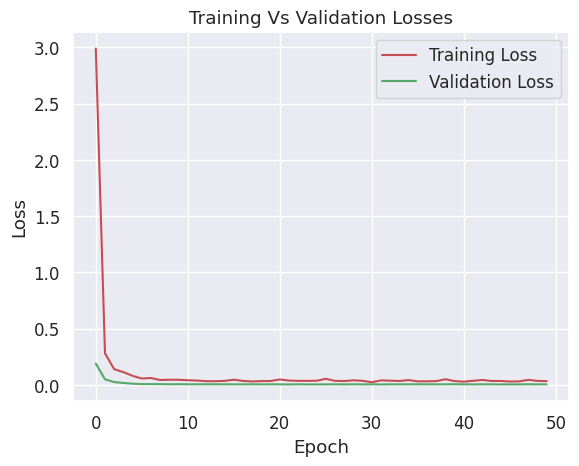

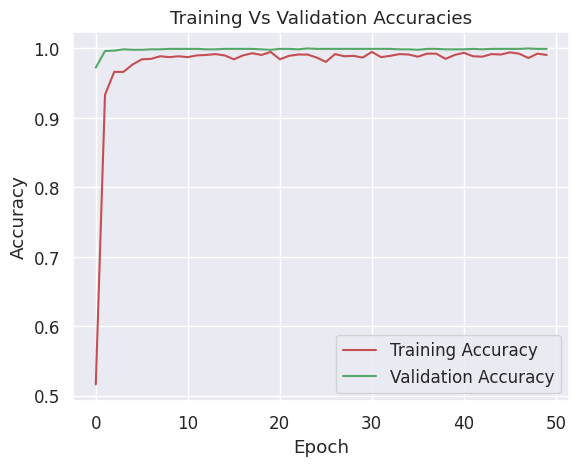

In [ ]:
#Plot the train & validation losses
plt.figure()
plt.title("Training Vs Validation Losses")
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.plot(epoch_counter_train,train_loss,color = 'r', label="Training Loss")
plt.plot(epoch_counter_val,val_loss,color = 'g', label="Validation Loss")
plt.legend()
plt.show()

tacc = [item.cpu().numpy() for item in train_acc]
vacc = [item.cpu().numpy() for item in val_acc]

#Plot the accuracies in train & validation
plt.figure()
plt.title("Training Vs Validation Accuracies")
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.plot(epoch_counter_train,tacc,color = 'r', label="Training Accuracy")
plt.plot(epoch_counter_val,vacc,color = 'g', label="Validation Accuracy")
plt.legend()
plt.show()

In [ ]:
!pip install torchnet

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import torchnet.meter.confusionmeter as cm

#Test the accuracy with test data
correct = 0
total = 0
with torch.no_grad():
    for i, (inputs, labels) in enumerate(dataloaders['test']):
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model_ft(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()

print('Accuracy of the network on the test images: %d %%' % (
    100 * correct / total))

#Class wise testing accuracy
class_correct = list(0. for i in range(8))
class_total = list(0. for i in range(8))
with torch.no_grad():
    for i, (inputs, labels) in enumerate(dataloaders['test']):
            inputs = inputs.to(device)
            labels = labels.to(device)
            outputs = model_ft(inputs)
            _, predicted = torch.max(outputs, 1)
            point = (predicted == labels).squeeze()
            for j in range(len(labels)):
                label = labels[j]
                class_correct[label] += point[j].item()
                class_total[label] += 1

for i in range(8):
    print('Accuracy of %5s : %2d %%' % (
        class_names[i], 100 * class_correct[i] / class_total[i]))


# #Get the confusion matrix for testing data
# confusion_matrix = cm.ConfusionMeter(8)
# with torch.no_grad():
#     for i, (inputs, labels) in enumerate(dataloaders['test']):
#         inputs = inputs.to(device)
#         labels = labels.to(device)
#         outputs = model_ft(inputs)
#         _, predicted = torch.max(outputs, 1)
#         confusion_matrix.add(predicted, labels)
#     print(confusion_matrix.conf)

#Confusion matrix as a heatmap
con_m = confusion_matrix.conf
df_con_m = pd.DataFrame(con_m, index= [i for i in class_names], columns = [i for i in class_names])
sn.set(font_scale= 1.1)
sn.heatmap(df_con_m, annot=True,fmt='g' ,  annot_kws={"size" : 10}, cbar = False, cmap="Blues") 

Accuracy of the network on the test images: 58 %
Accuracy of    00 : 59 %
Accuracy of    01 : 95 %
Accuracy of    02 : 31 %
Accuracy of    03 : 80 %
Accuracy of    04 : 78 %
Accuracy of    05 : 52 %
Accuracy of    06 : 38 %
Accuracy of    07 : 23 %


AssertionError: ignored

In [ ]:
import os
import csv
from PIL import Image
import torch
import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import timm
import copy
import time

# Device definition
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to get list of image files in test folder
def get_image_list(folder_path):
    image_list = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith(".png") or file.endswith(".jpg"):
                image_list.append(os.path.join(root, file))
    return image_list

# Predict images and return the predictions
def predict_images(image_list, model, idx_to_class):
    predictions = []
    for img_path in image_list:
        img = Image.open(img_path)
        img_tensor = transforms.ToTensor()(img)
        img_tensor = img_tensor.unsqueeze(0)
        img_tensor = img_tensor.to(device)
        prob = model(img_tensor)
        pred = torch.max(prob, 1).indices
        pred = pred.item()
        predictions.append(pred)
    return predictions

# Create the datasets
data_dir = '/content/drive/MyDrive/aiunict-2023/train_crop_masked'

train1_tfm = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(degrees=10),
    transforms.ColorJitter(),
    transforms.RandomInvert(),
    transforms.RandomSolarize(threshold=192.0),
    transforms.RandomEqualize(),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

valid1_tfm = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

image_datasets = {
    'train': datasets.ImageFolder(root=data_dir, transform=train1_tfm),
    'val': datasets.ImageFolder(root=data_dir, transform=valid1_tfm)
}

# Create the dataloaders
dataloaders = {
    'train': DataLoader(image_datasets['train'], batch_size=16, shuffle=True, num_workers=4),
    'val': DataLoader(image_datasets['val'], batch_size=16, shuffle=True, num_workers=4)
}

# Get the dataset sizes and class names
dataset_sizes = {x: len(image_datasets[x]) for x in ['train', 'val']}
class_names = image_datasets['train'].classes

# Train the model
def train_model(model, criterion, optimizer, scheduler, num_epochs):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch + 1, num_epochs))
        print('-' * 10)

        for phase in ['train', 'val']:
            if phase == 'train':
                scheduler.step()
                model.train()
            else:
                model.eval()

            running_loss = 0.0
            running_corrects = 0

            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device)
                labels = labels.to(device)

                optimizer.zero_grad()

                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)

            if phase == "train":
                train_loss.append(running_loss / dataset_sizes[phase])
                train_acc.append(running_corrects.double() / dataset_sizes[phase])
                epoch_counter_train.append(epoch)
            if phase == "val":
                val_loss.append(running_loss / dataset_sizes[phase])
                val_acc.append(running_corrects.double() / dataset_sizes[phase])
                epoch_counter_val.append(epoch)

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    model.load_state_dict(best_model_wts)
    return model

# Load the pre-trained EfficientNet-B0 model
model = timm.create_model('efficientnet_b0', pretrained=True)
num_ftrs = model.classifier.in_features
model.classifier = torch.nn.Linear(num_ftrs, 8)  # Replace classifier layer
model = model.to(device)

# Using Adam as the parameter optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001, betas=(0.9, 0.999))

# Decay LR by a factor of 0.1 every 7 epochs
exp_lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=7, gamma=0.1)

# Loss function
criterion = torch.nn.CrossEntropyLoss()

# Train the model
model = train_model(model, criterion, optimizer, exp_lr_scheduler, num_epochs=50)

# Execution of the prediction and saving results in a CSV file
test_folder = '/content/drive/MyDrive/aiunict-2023/test_crop'
image_list = get_image_list(test_folder)
predictions = predict_images(image_list, model, class_names)

output_file = '/content/drive/MyDrive/aiunict-2023/submission1.csv'
with open(output_file, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['image', 'class'])
    for i, img_path in enumerate(image_list):
        image_name = os.path.basename(img_path)
        pred = predictions[i]
        writer.writerow([image_name, pred])


Epoch 1/50
----------


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:139: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  warnings.warn("Detected call of `lr_scheduler.step()` before `optimizer.step()`. "


train Loss: 1.2724 Acc: 0.7050
val Loss: 0.2037 Acc: 0.9906

Epoch 2/50
----------
train Loss: 0.2319 Acc: 0.9587
val Loss: 0.0305 Acc: 0.9988

Epoch 3/50
----------
train Loss: 0.0828 Acc: 0.9850
val Loss: 0.0136 Acc: 0.9994

Epoch 4/50
----------
train Loss: 0.0609 Acc: 0.9831
val Loss: 0.0101 Acc: 0.9994

Epoch 5/50
----------
train Loss: 0.0342 Acc: 0.9938
val Loss: 0.0059 Acc: 0.9994

Epoch 6/50
----------
train Loss: 0.0373 Acc: 0.9875
val Loss: 0.0050 Acc: 1.0000

Epoch 7/50
----------
train Loss: 0.0367 Acc: 0.9944
val Loss: 0.0043 Acc: 1.0000

Epoch 8/50
----------
train Loss: 0.0288 Acc: 0.9938
val Loss: 0.0041 Acc: 1.0000

Epoch 9/50
----------
train Loss: 0.0225 Acc: 0.9975
val Loss: 0.0037 Acc: 1.0000

Epoch 10/50
----------
train Loss: 0.0248 Acc: 0.9975
val Loss: 0.0035 Acc: 1.0000

Epoch 11/50
----------
train Loss: 0.0225 Acc: 0.9944
val Loss: 0.0038 Acc: 1.0000

Epoch 12/50
----------
train Loss: 0.0159 Acc: 0.9981
val Loss: 0.0032 Acc: 1.0000

Epoch 13/50
----------


In [ ]:
import os
import csv
from PIL import Image
import torch
import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

# Device definition
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to get list of image files in test folder
def get_image_list(folder_path):
    image_list = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith(".png") or file.endswith(".jpg"):
                image_list.append(os.path.join(root, file))
    return image_list

# Predict images and return the predictions
def predict_images(image_list, model, idx_to_class):
    predictions = []
    for img_path in image_list:
        img = Image.open(img_path)
        img_tensor = transforms.ToTensor()(img)
        img_tensor = img_tensor.unsqueeze(0)
        img_tensor = img_tensor.to(device)
        prob = model(img_tensor)
        pred = torch.max(prob, 1).indices
        pred = pred.item()
        predictions.append(pred)
    return predictions

# Model
model = resnet18(pretrained=True)
model.fc = torch.nn.Linear(512, 8)  # Replace fully connected layer
model = model.to(device)

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=3e-4, weight_decay=0.0001)

# Loss function
loss_fn = torch.nn.CrossEntropyLoss()

# Training loop
for epoch in range(10):
    model.train()
    train_loss = 0.0
    train_correct = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)
        loss = loss_fn(outputs, labels)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        # Calculate training accuracy
        _, predicted = torch.max(outputs, 1)
        train_correct += (predicted == labels).sum().item()

        train_loss += loss.item()

    # Calculate average training loss and accuracy
    train_loss /= len(train_loader.dataset)
    train_accuracy = train_correct / len(train_loader.dataset)

    # Validation loop
    model.eval()
    val_loss = 0.0
    val_correct = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model(inputs)
            loss = loss_fn(outputs, labels)

            # Calculate validation accuracy
            _, predicted = torch.max(outputs, 1)
            val_correct += (predicted == labels).sum().item()

            val_loss += loss.item()

    # Calculate average validation loss and accuracy
    val_loss /= len(valid_loader.dataset)
    val_accuracy = val_correct / len(valid_loader.dataset)

    # Print epoch statistics
    print(f"Epoch: {epoch+1}, Train Loss: {train_loss:.4f}, Train Acc: {train_accuracy:.4f}, "
          f"Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.4f}")

# Execution of the prediction
test_folder = '/content/drive/MyDrive/aiunict-2023/test_crop'
image_list = get_image_list(test_folder)
predictions = predict_images(image_list, model, idx_to_class)

# Saving of results in a CSV file
output_file = '/content/drive/MyDrive/aiunict-2023/submission1.csv'
with open(output_file, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['image', 'class'])
    for i, img_path in enumerate(image_list):
        image_name = os.path.basename(img_path)
        pred = predictions[i]  # get the current prediction
        class_name = idx_to_class.get(pred)  # get the name of the class corresponding to the predicted index
        writer.writerow([image_name, pred])


Epoch: 1, Train Loss: 0.0087, Train Acc: 0.9102, Val Loss: 0.0016, Val Acc: 0.9812
Epoch: 2, Train Loss: 0.0009, Train Acc: 0.9922, Val Loss: 0.0003, Val Acc: 0.9938
Epoch: 3, Train Loss: 0.0005, Train Acc: 0.9953, Val Loss: 0.0003, Val Acc: 1.0000
Epoch: 4, Train Loss: 0.0002, Train Acc: 0.9992, Val Loss: 0.0001, Val Acc: 1.0000
Epoch: 5, Train Loss: 0.0004, Train Acc: 0.9969, Val Loss: 0.0004, Val Acc: 0.9938
Epoch: 6, Train Loss: 0.0003, Train Acc: 0.9969, Val Loss: 0.0001, Val Acc: 1.0000
Epoch: 7, Train Loss: 0.0004, Train Acc: 0.9984, Val Loss: 0.0001, Val Acc: 1.0000
Epoch: 8, Train Loss: 0.0004, Train Acc: 0.9977, Val Loss: 0.0003, Val Acc: 1.0000
Epoch: 9, Train Loss: 0.0018, Train Acc: 0.9844, Val Loss: 0.0155, Val Acc: 0.8938
Epoch: 10, Train Loss: 0.0022, Train Acc: 0.9773, Val Loss: 0.0093, Val Acc: 0.9062


In [ ]:
# Model - EfficientNetB0, Epoch= 10

model_efficientnetb0 = EfficientNet.from_pretrained('efficientnet-b0')
num_ftrs = model_efficientnetb0._fc.in_features
model_efficientnetb0._fc = torch.nn.Linear(num_ftrs, 8)  # Replace fully connected layer
model_efficientnetb0 = model_efficientnetb0.to(device)

# Optimizer
optimizer_efficientnetb0 = torch.optim.Adam(model_efficientnetb0.parameters(), lr=3e-4, weight_decay=0.0001)

# Training loop - EfficientNetB0
for epoch in range(10):
    model_efficientnetb0.train()
    train_loss = 0.0
    train_correct = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_efficientnetb0.zero_grad()

        # Forward pass
        outputs = model_efficientnetb0(inputs)
        loss = loss_fn(outputs, labels)

        # Backward pass and optimization
        loss.backward()
        optimizer_efficientnetb0.step()

        # Calculate training accuracy
        _, predicted = torch.max(outputs, 1)
        train_correct += (predicted == labels).sum().item()

        train_loss += loss.item()

    # Calculate average training loss and accuracy
    train_loss /= len(train_loader.dataset)
    train_accuracy = train_correct / len(train_loader.dataset)

    # Validation loop
    model_efficientnetb0.eval()
    val_loss = 0.0
    val_correct = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model_efficientnetb0(inputs)
            loss = loss_fn(outputs, labels)

            # Calculate validation accuracy
            _, predicted = torch.max(outputs, 1)
            val_correct += (predicted == labels).sum().item()

            val_loss += loss.item()

    # Calculate average validation loss and accuracy
    val_loss /= len(valid_loader.dataset)
    val_accuracy = val_correct / len(valid_loader.dataset)

    # Print epoch statistics
    print(f"Epoch: {epoch+1}, Train Loss: {train_loss:.4f}, Train Acc: {train_accuracy:.4f}, "
          f"Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.4f}")

# Execution of the prediction - EfficientNetB0
test_folder = '/content/drive/MyDrive/aiunict-2023/test_crop'
image_list = get_image_list(test_folder)
predictions = predict_images(image_list, model_efficientnetb0, idx_to_class)

# Saving of results in a CSV file
output_file = '/content/drive/MyDrive/aiunict-2023/submission1_efficientnetb0.csv'
with open(output_file, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['image', 'class'])
    for i, img_path in enumerate(image_list):
        image_name = os.path.basename(img_path)
        pred = predictions[i]  # get the current prediction
        class_name = idx_to_class.get(pred)  # get the name of the class corresponding to the predicted index
        writer.writerow([image_name, pred])



Loaded pretrained weights for efficientnet-b0
Epoch: 1, Train Loss: 0.0308, Train Acc: 0.8008, Val Loss: 0.0109, Val Acc: 0.9437
Epoch: 2, Train Loss: 0.0031, Train Acc: 0.9867, Val Loss: 0.0026, Val Acc: 0.9875
Epoch: 3, Train Loss: 0.0010, Train Acc: 0.9961, Val Loss: 0.0019, Val Acc: 0.9875
Epoch: 4, Train Loss: 0.0006, Train Acc: 0.9984, Val Loss: 0.0017, Val Acc: 0.9875
Epoch: 5, Train Loss: 0.0003, Train Acc: 0.9992, Val Loss: 0.0008, Val Acc: 0.9938
Epoch: 6, Train Loss: 0.0003, Train Acc: 0.9992, Val Loss: 0.0004, Val Acc: 1.0000
Epoch: 7, Train Loss: 0.0003, Train Acc: 1.0000, Val Loss: 0.0007, Val Acc: 0.9938
Epoch: 8, Train Loss: 0.0006, Train Acc: 0.9953, Val Loss: 0.0002, Val Acc: 1.0000
Epoch: 9, Train Loss: 0.0004, Train Acc: 0.9977, Val Loss: 0.0002, Val Acc: 1.0000
Epoch: 10, Train Loss: 0.0004, Train Acc: 0.9984, Val Loss: 0.0002, Val Acc: 1.0000


In [ ]:
import os
import csv
from PIL import Image
import torch
import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import timm

# Device definition
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Function to get list of image files in test folder
def get_image_list(folder_path):
    image_list = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith(".png") or file.endswith(".jpg"):
                image_list.append(os.path.join(root, file))
    return image_list

# Predict images and return the predictions
def predict_images(image_list, model, idx_to_class):
    predictions = []
    for img_path in image_list:
        img = Image.open(img_path)
        img_tensor = transforms.ToTensor()(img)
        img_tensor = img_tensor.unsqueeze(0)
        img_tensor = img_tensor.to(device)
        prob = model(img_tensor)
        pred = torch.max(prob, 1).indices
        pred = pred.item()
        predictions.append(pred)
    return predictions

# Model
model = timm.create_model('efficientnet_b0', pretrained=True)
num_ftrs = model.classifier.in_features
model.classifier = torch.nn.Linear(num_ftrs, 8)  # Replace classifier layer
model = model.to(device)

# Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=3e-4, weight_decay=0.0001)

# Loss function
loss_fn = torch.nn.CrossEntropyLoss()

# Training loop and validation loop...

# Execution of the prediction and saving results in a CSV file
test_folder = '/content/drive/MyDrive/aiunict-2023/test_crop'
image_list = get_image_list(test_folder)
predictions = predict_images(image_list, model, idx_to_class)

output_file = '/content/drive/MyDrive/aiunict-2023/submission1.csv'
with open(output_file, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['image', 'class'])
    for i, img_path in enumerate(image_list):
        image_name = os.path.basename(img_path)
        pred = predictions[i]
        class_name = idx_to_class.get(pred)
        writer.writerow([image_name, pred])


# **Grad-CAM**

In [ ]:
!pip install captum --upgrade

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 10.0 MB/s eta 0:00:00


# **Model Inspection**

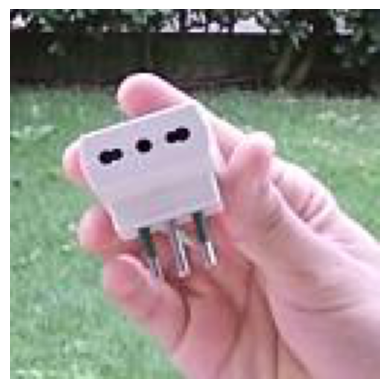

In [ ]:
test_img = Image.open('/content/drive/MyDrive/aiunict-2023/test_crop/045.jpg')
test_img_data = np.asarray(test_img)
plt.axis('off')
plt.imshow(test_img_data)
plt.show()

In [ ]:
import torch

# Check if CUDA is available and choose device
dev = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

transform = transforms.Compose([
    transforms.Resize(224),
    transforms.ToTensor()])

# Standard ImageNet normalization
transform_normalize = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225])

transformed_img = transform(test_img)
input_img = transform_normalize(transformed_img)
input_img = input_img.unsqueeze(0).to(dev)
transformed_img = transformed_img.to(dev)


In [ ]:
import torch.nn.functional as F

output = model(input_img)
output = F.softmax(output, dim=1)
prediction_score, pred_label_idx = torch.topk(output, 1)
pred_label_idx.squeeze_()
print(pred_label_idx)

tensor(0, device='cuda:0')


# **Guided GradCAM**

In [ ]:
!pip install captum
!pip install git+https://github.com/jacobgil/pytorch-grad-cam.git


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/jacobgil/pytorch-grad-cam.git to /tmp/pip-req-build-3o3rqa04
  Running command git clone --filter=blob:none --quiet https://github.com/jacobgil/pytorch-grad-cam.git /tmp/pip-req-build-3o3rqa04
  Resolved https://github.com/jacobgil/pytorch-grad-cam.git to commit 2183a9cbc1bd5fc1d8e134b4f3318c3b6db5671f
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.4.6-py3-none-any.whl size=37423 sha256=dbd118e7271bc53237a3747748c53c83881d85859c4af7eca3487b5fb9b62e86
  Stored in directory: /tmp/pip-ephem-wheel-cache-4xh0cxpz/wheels/23/11/66/71a38b0c29ba4ec5f62105a2145278613855bc9c94eecf630d
Successfully built grad-cam


In [ ]:
import os
import torch
import numpy as np
from PIL import Image
from torchvision.transforms import transforms
from efficientnet_pytorch import EfficientNet
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget

# Define the path to the image
image_path = "/content/drive/MyDrive/aiunict-2023/test/000.jpg"

# Load the image
image = Image.open(image_path)

# Define the model and target layers
model = EfficientNet.from_pretrained('efficientnet-b0')
target_layers = [model._blocks[-1]._project_conv]

# Preprocess the image
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Apply image preprocessing transformations
input_tensor = data_transforms(image)
input_tensor = torch.unsqueeze(input_tensor, 0)

# Create the GradCAM object
cam = GradCAM(model=model, target_layers=target_layers, use_cuda=True)

# Specify the target for generating Class Activation Maps
targets = [ClassifierOutputTarget(281)]

# Generate the Class Activation Map
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Access the CAM for the first image in the batch
grayscale_cam = grayscale_cam[0, :]


Loaded pretrained weights for efficientnet-b0


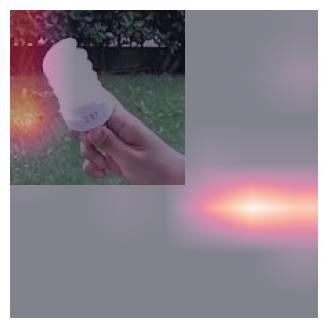

In [ ]:
plt.figure(figsize = (4, 4))
plt.axis('off')
plt.imshow(output)
plt.imshow(grayscale_cam, alpha=0.5)

In [ ]:
from captum.attr import GuidedGradCam
from torchvision import models
import numpy as np
import matplotlib.cm as cm
from captum.visualization import visualization as viz

# Load the EfficientNetB0 model
model = models.efficientnet_b0(pretrained=True)
model.to(device)
model.eval()

# Select the layer for Guided Grad-CAM
target_layer = model._blocks[7]._project_conv

# Create the GuidedGradCam object
gg = GuidedGradCam(model, target_layer)

# Assuming `input_img` is your input image tensor and `pred_label_idx` is the predicted class index
gg_attr = gg.attribute(input_img, pred_label_idx)

# Visualize the Guided Grad-CAM attribution
_ = viz.visualize_image_attr_multiple(
    np.transpose(gg_attr.squeeze().cpu().detach().numpy(), (1, 2, 0)),
    np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1, 2, 0)),
    ["original_image", "heat_map"],
    ["all", "positive"],
    cmap=cm.seismic,
    show_colorbar=True
)


ModuleNotFoundError: ignored

In [ ]:
gg = GuidedGradCam(model, model.block_3x3_exit_2)
gg_attr = gg.attribute(input_img, pred_label_idx)
_ = viz.visualize_image_attr_multiple(np.transpose(gg_attr.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      np.transpose(transformed_img.squeeze().cpu().detach().numpy(), (1,2,0)),
                                      ["original_image", "heat_map"],
                                      ["all", "positive"],
                                      cmap=cm.seismic,
                                      show_colorbar=True)

AttributeError: ignored

In [ ]:
pip install timm

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 51.2 MB/s eta 0:00:00


In [ ]:
# Model - EfficientNetB0
model_efficientnetb0 = EfficientNet.from_pretrained('efficientnet-b0')
num_ftrs = model_efficientnetb0._fc.in_features
model_efficientnetb0._fc = torch.nn.Linear(num_ftrs, 8)  # Replace fully connected layer
model_efficientnetb0 = model_efficientnetb0.to(device)

# Optimizer
optimizer_efficientnetb0 = torch.optim.Adam(model_efficientnetb0.parameters(), lr=3e-4, weight_decay=0.0001)

# Training loop - EfficientNetB0
for epoch in range(50):
    model_efficientnetb0.train()
    train_loss = 0.0
    train_correct = 0

    for inputs, labels in train_loader:
        inputs = inputs.to(device)
        labels = labels.to(device)

        optimizer_efficientnetb0.zero_grad()

        # Forward pass
        outputs = model_efficientnetb0(inputs)
        loss = loss_fn(outputs, labels)

        # Backward pass and optimization
        loss.backward()
        optimizer_efficientnetb0.step()

        # Calculate training accuracy
        _, predicted = torch.max(outputs, 1)
        train_correct += (predicted == labels).sum().item()

        train_loss += loss.item()

    # Calculate average training loss and accuracy
    train_loss /= len(train_loader.dataset)
    train_accuracy = train_correct / len(train_loader.dataset)

    # Validation loop
    model_efficientnetb0.eval()
    val_loss = 0.0
    val_correct = 0

    with torch.no_grad():
        for inputs, labels in valid_loader:
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass
            outputs = model_efficientnetb0(inputs)
            loss = loss_fn(outputs, labels)

            # Calculate validation accuracy
            _, predicted = torch.max(outputs, 1)
            val_correct += (predicted == labels).sum().item()

            val_loss += loss.item()

    # Calculate average validation loss and accuracy
    val_loss /= len(valid_loader.dataset)
    val_accuracy = val_correct / len(valid_loader.dataset)

    # Print epoch statistics
    print(f"Epoch: {epoch+1}, Train Loss: {train_loss:.4f}, Train Acc: {train_accuracy:.4f}, "
          f"Val Loss: {val_loss:.4f}, Val Acc: {val_accuracy:.4f}")

# Execution of the prediction - EfficientNetB0
test_folder = '/content/drive/MyDrive/aiunict-2023/test_crop'
image_list = get_image_list(test_folder)
predictions = predict_images(image_list, model_efficientnetb0, idx_to_class)

# Saving of results in a CSV file
output_file = '/content/drive/MyDrive/aiunict-2023/submission1_efficientnetb0.csv'
with open(output_file, 'w', newline='') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['image', 'class'])
    for i, img_path in enumerate(image_list):
        image_name = os.path.basename(img_path)
        pred = predictions[i]  # get the current prediction
        class_name = idx_to_class.get(pred)  # get the name of the class corresponding to the predicted index
        writer.writerow([image_name, pred])


Loaded pretrained weights for efficientnet-b0
Epoch: 1, Train Loss: 0.0325, Train Acc: 0.7750, Val Loss: 0.0095, Val Acc: 0.9500
Epoch: 2, Train Loss: 0.0030, Train Acc: 0.9867, Val Loss: 0.0017, Val Acc: 1.0000
Epoch: 3, Train Loss: 0.0012, Train Acc: 0.9938, Val Loss: 0.0011, Val Acc: 0.9938
Epoch: 4, Train Loss: 0.0006, Train Acc: 0.9977, Val Loss: 0.0007, Val Acc: 1.0000
Epoch: 5, Train Loss: 0.0006, Train Acc: 0.9969, Val Loss: 0.0005, Val Acc: 1.0000
Epoch: 6, Train Loss: 0.0003, Train Acc: 1.0000, Val Loss: 0.0004, Val Acc: 1.0000
Epoch: 7, Train Loss: 0.0005, Train Acc: 0.9984, Val Loss: 0.0005, Val Acc: 0.9938
Epoch: 8, Train Loss: 0.0002, Train Acc: 1.0000, Val Loss: 0.0003, Val Acc: 1.0000
Epoch: 9, Train Loss: 0.0002, Train Acc: 0.9992, Val Loss: 0.0002, Val Acc: 1.0000
Epoch: 10, Train Loss: 0.0002, Train Acc: 0.9992, Val Loss: 0.0002, Val Acc: 1.0000
Epoch: 11, Train Loss: 0.0002, Train Acc: 0.9992, Val Loss: 0.0001, Val Acc: 1.0000
Epoch: 12, Train Loss: 0.0001, Train Ac

# **Fill The Submission**

In [ ]:
import numpy as np
import pandas as pd
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms
import torch
from PIL import Image

class CustomDataset(Dataset):
    def __init__(self, dataframe, transform):
        self.dataframe = dataframe
        self.transform = transform

    def __getitem__(self, index):
        im_path = os.path.join("test", self.dataframe["image"][index])
        image = Image.open(im_path)
        output = remove(image)
        array = np.array(output)
        cropped_im = array[self.dataframe["y1"][index]:self.dataframe["y1"][index]+self.dataframe["y2"][index]
                    ,self.dataframe["x1"][index]:self.dataframe["x1"][index]+self.dataframe["x2"][index]]
        
        # cropped_im = cropped_im[:,:,::-1]
        PIL_image = Image.fromarray(np.uint8(cropped_im)).convert('RGB')
        image = data_transforms(PIL_image)
        return image

    def __len__(self):
        return len(self.dataframe)

data_transforms = transforms.Compose([
                  transforms.Resize((224,224)),
                  transforms.ToTensor(),
                  transforms.CenterCrop(224),
                  transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
                  ])


df_pred = pd.read_csv("test.csv")

data_test = CustomDataset(dataframe=df_pred, transform = data_transforms)
test_dataloader = DataLoader(data_test)



In [ ]:
#takes about 30 minutes 

from rembg import remove
from tqdm import tqdm 


preds =[]
with torch.no_grad():
    for i, (inputs) in tqdm(enumerate(test_dataloader)):
            inputs = inputs.to(device)
            outputs = model_ft(inputs)
            _, predicted = torch.max(outputs.data, 1)
            preds.append(predicted)


800it [31:23,  2.35s/it]


In [ ]:
len(preds)

800

In [ ]:
final = [item.cpu().numpy()[0] for item in preds]

In [ ]:
np.unique(final)

array([0, 1, 2, 3, 4, 5, 6, 7])

In [ ]:
torch.save(model_ft.state_dict(), "eff_wb.pth")

In [ ]:
submission = pd.DataFrame({'image' : df_pred.iloc[:,0], 'class': final})
submission.to_csv('submission.csv', index = False)

# **Grad-CAM**

In [ ]:
from pytorch_grad_cam import GradCAM, HiResCAM, ScoreCAM, GradCAMPlusPlus, AblationCAM, XGradCAM, EigenCAM, FullGrad
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
from torchvision.models import resnet50



index = 100
target_layers = [model_ft.features[-1][0]]

image = Image.open(os.path.join("test", df_pred["image"][index]))
output = remove(image)
array = np.array(output)
cropped_im = array[df_pred["y1"][index]:df_pred["y1"][index]+df_pred["y2"][index]
          ,df_pred["x1"][index]:df_pred["x1"][index]+df_pred["x2"][index]]

# cropped_im = cropped_im[:,:,::-1]
PIL_image = Image.fromarray(np.uint8(cropped_im)).convert('RGB')
array = data_transforms(PIL_image)
array = torch.unsqueeze(array, 0)

input_tensor = array
# Create an input tensor image for your model..
# Note: input_tensor can be a batch tensor with several images!

# Construct the CAM object once, and then re-use it on many images:
cam = GradCAM(model=model_ft, target_layers=target_layers, use_cuda=True)

# You can also use it within a with statement, to make sure it is freed,
# In case you need to re-create it inside an outer loop:
# with GradCAM(model=model, target_layers=target_layers, use_cuda=args.use_cuda) as cam:
#   ...

# We have to specify the target we want to generate
# the Class Activation Maps for.
# If targets is None, the highest scoring category
# will be used for every image in the batch.
# Here we use ClassifierOutputTarget, but you can define your own custom targets
# That are, for example, combinations of categories, or specific outputs in a non standard model.

targets = [ClassifierOutputTarget(281)]

# You can also pass aug_smooth=True and eigen_smooth=True, to apply smoothing.
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# In this example grayscale_cam has only one image in the batch:
grayscale_cam = grayscale_cam[0, :]



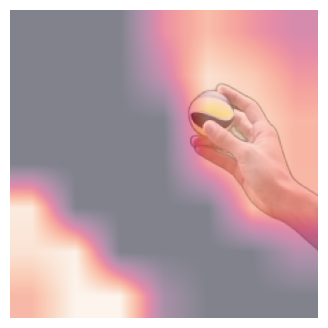

In [ ]:

plt.figure(figsize = (4, 4))
plt.axis('off')
plt.imshow(output)
plt.imshow(grayscale_cam, alpha=0.5)
